<a href="https://colab.research.google.com/github/Zachary-Fernandes/CSCI-6962/blob/main/fernazHW2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Homework 2
#####Zachary Fernandes
#####Projects in Machine Learning and AI

### The Problem
The machine learning problem I wanted to solve involved the [NASA Nearest Earth Objects dataset](https://www.kaggle.com/datasets/sameepvani/nasa-nearest-earth-objects?select=neo_v2.csv) found on Kaggle. The exact problem here is determining whether or not an asteroid is a hazard to humans given the dataset's features - estimated diameter, relative velocity, miss distance, and absolute magnitude.

I solved this problem in Homework 1 with logistic regression. This is the best selection for solving this problem because determining whether or not an asteroid is hazard is a binary classification task. If we used linear regression here, we would get a continuous outcome as a solution. What I want to do, however, requires a categorical, binary output, that being hazardous or non-hazardous. This binary classification is a problem that is appropriate for logistic regression to solve, which is why it is the right tool for this job.

For Homework 2, I will be using various decision tree and ensemble learning techniques to solve this problem. 

### Setup

In [ ]:
!pip install imbalanced-learn
!pip install graphviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# import required libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import random
import graphviz

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold 
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn import tree
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler

from imblearn.over_sampling import SMOTE
import warnings
warnings.filterwarnings("ignore")

### Exploratory Data Analysis
Below are the steps I take to perform Exploratory Data Analysis.

#### Getting the Data

In [ ]:
# data source: https://www.kaggle.com/datasets/sameepvani/nasa-nearest-earth-objects
# note: we have combined Training and Testing data from Kaggle into a single data frame
df = pd.read_csv('neo_v2.csv')

Data Dictionary


| **Variable**       | **Definition**                                                |
|--------------------|---------------------------------------------------------------|
| id                 | Unique Identifier for each Asteroid                           |
| name               | Name given by NASA                                            |
| est_diameter_min   | Minimum Estimated Diameter in Kilometres                      |
| est_diameter_max   | Maximum Estimated Diameter in Kilometres                      |
| relative_velocity  | Velocity Relative to Earth in Kmph                            |
| miss_distance      | Distance in Kilometres missed                                 |
| orbiting_body      | Planet that the asteroid orbits                               |
| sentry_object      | Included in sentry - automated collision monitoring system    |
| absolute_magnitude | Describes intrinsic luminosity                                |
| hazardous          | Boolean feature that shows whether asteroid is harmful or not |

### Exploring the Data

In [ ]:
# viewing the first few rows of the data
df.head()

,id,name,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,orbiting_body,sentry_object,absolute_magnitude,hazardous
0,2162635,162635 (2000 SS164),1.198271,2.679415,13569.249224,5.483974e+07,Earth,False,16.73,False
1,2277475,277475 (2005 WK4),0.265800,0.594347,73588.726663,6.143813e+07,Earth,False,20.00,True
2,2512244,512244 (2015 YE18),0.722030,1.614507,114258.692129,4.979872e+07,Earth,False,17.83,False
3,3596030,(2012 BV13),0.096506,0.215794,24764.303138,2.543497e+07,Earth,False,22.20,False
4,3667127,(2014 GE35),0.255009,0.570217,42737.733765,4.627557e+07,Earth,False,20.09,True


In [ ]:
# what's the data size?
df.shape
# there are not many features, but there are plenty of examples

(90836, 10)

In [ ]:
# are there any missing values?
df.isna().sum()
# there are no missing values

id                    0
name                  0
est_diameter_min      0
est_diameter_max      0
relative_velocity     0
miss_distance         0
orbiting_body         0
sentry_object         0
absolute_magnitude    0
hazardous             0
dtype: int64

In [ ]:
# general information about the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90836 entries, 0 to 90835
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  90836 non-null  int64  
 1   name                90836 non-null  object 
 2   est_diameter_min    90836 non-null  float64
 3   est_diameter_max    90836 non-null  float64
 4   relative_velocity   90836 non-null  float64
 5   miss_distance       90836 non-null  float64
 6   orbiting_body       90836 non-null  object 
 7   sentry_object       90836 non-null  bool   
 8   absolute_magnitude  90836 non-null  float64
 9   hazardous           90836 non-null  bool   
dtypes: bool(2), float64(5), int64(1), object(2)
memory usage: 5.7+ MB


In [ ]:
# statistics of the dataset (numeric columns)
df.describe()

,id,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude
count,9.083600e+04,90836.000000,90836.000000,90836.000000,9.083600e+04,90836.000000
mean,1.438288e+07,0.127432,0.284947,48066.918918,3.706655e+07,23.527103
std,2.087202e+07,0.298511,0.667491,25293.296961,2.235204e+07,2.894086
min,2.000433e+06,0.000609,0.001362,203.346433,6.745533e+03,9.230000
25%,3.448110e+06,0.019256,0.043057,28619.020645,1.721082e+07,21.340000
50%,3.748362e+06,0.048368,0.108153,44190.117890,3.784658e+07,23.700000
75%,3.884023e+06,0.143402,0.320656,62923.604633,5.654900e+07,25.700000
max,5.427591e+07,37.892650,84.730541,236990.128088,7.479865e+07,33.200000


In [ ]:
# statistics of the dataset (categorical columns - name and orbiting-body)
df.describe(include=['O'])

,name,orbiting_body
count,90836,90836
unique,27423,1
top,469219 Kamo`oalewa (2016 HO3),Earth
freq,43,90836


In [ ]:
# is the data imbalanced?
df.hazardous.value_counts(normalize=True) #normalizes the result
# at about 90% false and 10% true, this dataset is imbalanced

False    0.902682
True     0.097318
Name: hazardous, dtype: float64

#### Pairplot

''

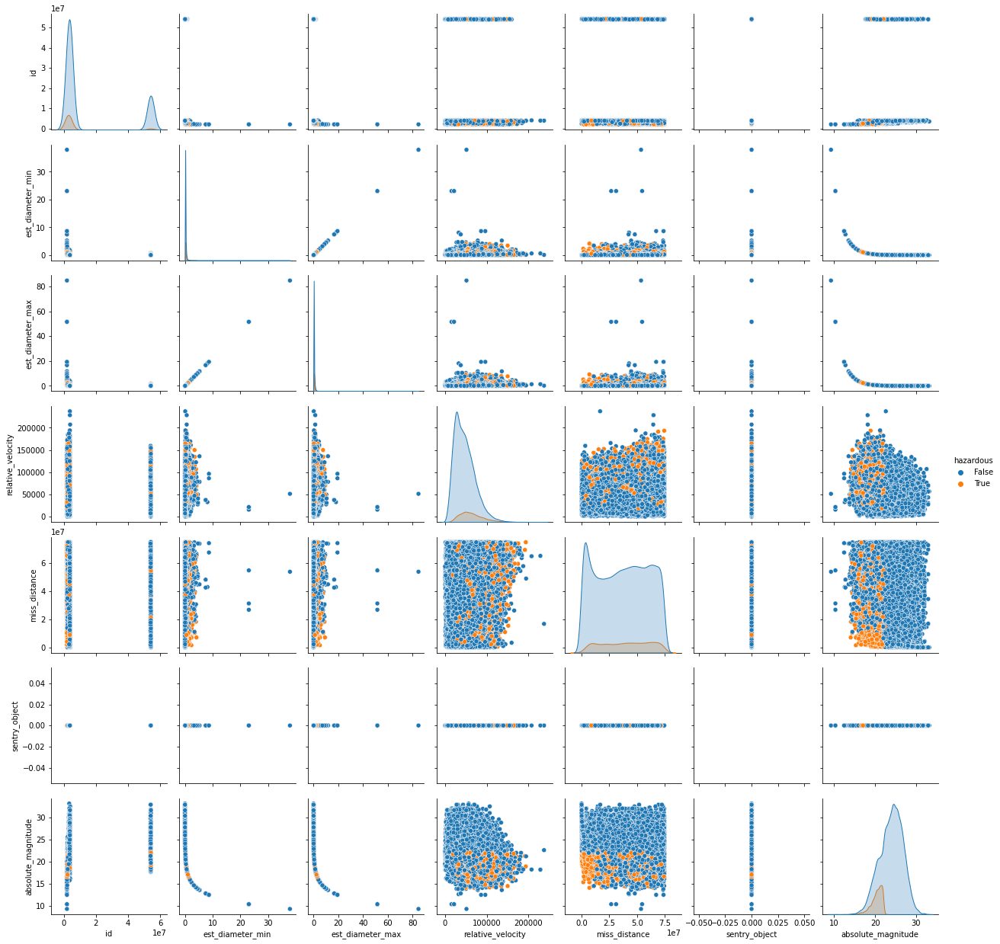

In [ ]:
# ploting pairwise relationships in the dataset
sns.pairplot(df, hue='hazardous')
,

#### Scatter Plot

''

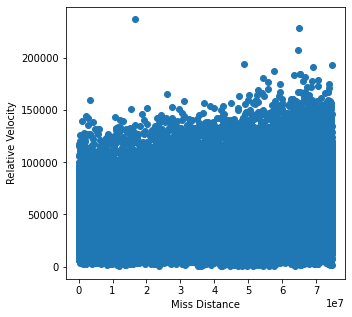

In [ ]:
# useful for identifying relationship (i.e. correlation) between two parameters
fig, ax = plt.subplots(figsize=(5,5))
ax.scatter(df.miss_distance, df.relative_velocity)
ax.set_xlabel('Miss Distance')
ax.set_ylabel('Relative Velocity')
,

''

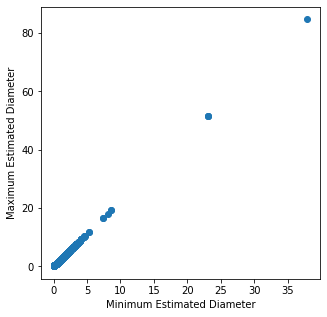

In [ ]:
fig, ax = plt.subplots(figsize=(5,5))
ax.scatter(df.est_diameter_min, df.est_diameter_max)
ax.set_xlabel('Minimum Estimated Diameter')
ax.set_ylabel('Maximum Estimated Diameter')
,

''

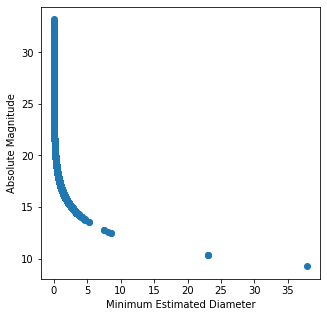

In [ ]:
fig, ax = plt.subplots(figsize=(5,5))
ax.scatter(df.est_diameter_min, df.absolute_magnitude)
ax.set_xlabel('Minimum Estimated Diameter')
ax.set_ylabel('Absolute Magnitude')
,

#### Pie Chart

''

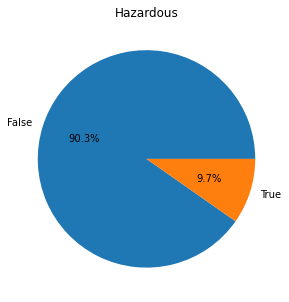

In [ ]:
# useful for depicting proportional data with each slice of pie representing a
# specific category
fig, ax = plt.subplots(figsize=(5,5))
ax.pie(x=df.hazardous.value_counts(), 
       labels=df.hazardous.value_counts().index,
       autopct='%1.1f%%')
ax.set_title('Hazardous')
,

#### Histogram

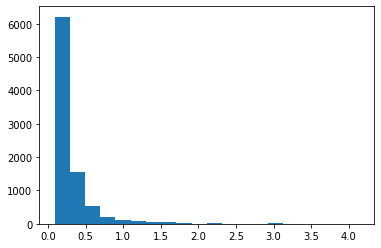

In [ ]:
# useful for visualizing the distribution of the data
test = df[df['hazardous'] == True]
test.shape
testCol = test['est_diameter_min'].values
testCol
testHist = np.asarray(testCol, dtype='float')
plt.hist(testHist, bins = 20)
plt.show()

### Adjustments from Exploratory Data Analysis.

During Exploratory Data Analysis, I noticed some of the features are not relevant for the purposes of this project. That being said, we can remove some of them.

Take, for example, the id and name features. For an asteroid, id is its unique identifier and name is its name provided by NASA. These features will not influence whether or not an asteroid is hazardous. Thus, we can drop them.

In [ ]:
df1 = df.drop(['id', 'name'], axis = 1)
df1.head()

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,orbiting_body,sentry_object,absolute_magnitude,hazardous
0,1.198271,2.679415,13569.249224,5.483974e+07,Earth,False,16.73,False
1,0.265800,0.594347,73588.726663,6.143813e+07,Earth,False,20.00,True
2,0.722030,1.614507,114258.692129,4.979872e+07,Earth,False,17.83,False
3,0.096506,0.215794,24764.303138,2.543497e+07,Earth,False,22.20,False
4,0.255009,0.570217,42737.733765,4.627557e+07,Earth,False,20.09,True


Next we notice the orbiting\_body feature. When we looked at the categorical columns, we noticed orbiting\_body had one unique value that appeared in 90836 instances. This unique value was Earth. It makes sense this appears for all 90836 rows of data as all of these potentially hazardous asteroids orbit Earth. Given this redundancy, we can drop the feature.

In [ ]:
df2 = df1.drop(['orbiting_body'], axis = 1)
df2.head()

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,sentry_object,absolute_magnitude,hazardous
0,1.198271,2.679415,13569.249224,5.483974e+07,False,16.73,False
1,0.265800,0.594347,73588.726663,6.143813e+07,False,20.00,True
2,0.722030,1.614507,114258.692129,4.979872e+07,False,17.83,False
3,0.096506,0.215794,24764.303138,2.543497e+07,False,22.20,False
4,0.255009,0.570217,42737.733765,4.627557e+07,False,20.09,True


There is a further feature we can drop, that being sentry\_object. When we look at the values for sentry\_object, we notice every answer it gives is false. True in this section means it is included in a sentry-automated collision monitoring system. Since all of these entries are marked False, there is no meaningful data we can glean from it. Thus, we can drop it.

In [ ]:
df3 = df2.drop(['sentry_object'], axis = 1)
df3.head()

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude,hazardous
0,1.198271,2.679415,13569.249224,5.483974e+07,16.73,False
1,0.265800,0.594347,73588.726663,6.143813e+07,20.00,True
2,0.722030,1.614507,114258.692129,4.979872e+07,17.83,False
3,0.096506,0.215794,24764.303138,2.543497e+07,22.20,False
4,0.255009,0.570217,42737.733765,4.627557e+07,20.09,True


I believe this dataset was a subset of a larger NASA dataset that included orbiting bodies (planets) other than Earth. Containing features like the orbiting\_body and the sentry\_object may not be relevant to matters purely revolving around Earth, but they would be pertinent in other situations in space. This would be why categories that seem irrelevant for my purposes still appear.

Now we observe how our features correlate with each other and with the target variable, hazardous:

''

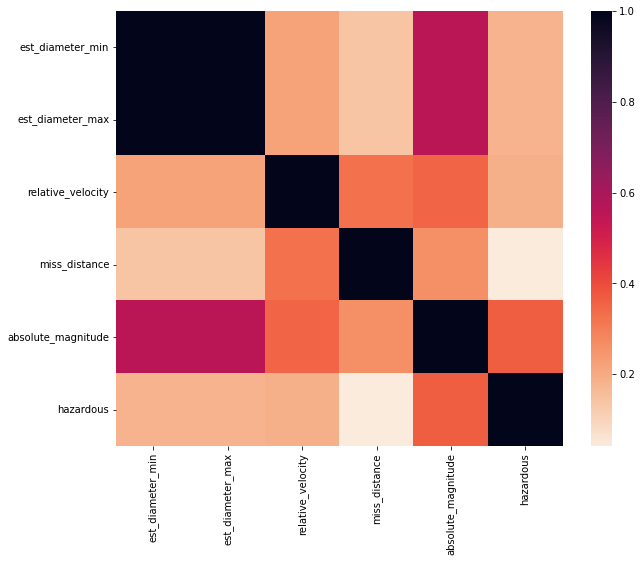

In [ ]:
fig, ax = plt.subplots(figsize=(10,8))
sns.heatmap(df3.corr().abs(),annot=False, ax=ax, cmap='rocket_r')
,

In [ ]:
# feature correlation with target variable
df3.corr()['hazardous'].sort_values(ascending=False)

hazardous             1.000000
relative_velocity     0.191185
est_diameter_max      0.183363
est_diameter_min      0.183363
miss_distance         0.042302
absolute_magnitude   -0.365267
Name: hazardous, dtype: float64

#### Oversampling to Counter Bias

We recognize how imbalanced the data is, approximately 90% non-hazardous and 10% hazardous. We must resolve this with oversampling. For our purposes, we will use SMOTE ([Synthetic Minority Over-sampling Technique](https://imbalanced-learn.org/stable/references/generated/imblearn.over_sampling.SMOTE.html)) to oversample.

In [ ]:
# independent variables
X = df3.drop(['hazardous'], axis=1)

# dependent/target variable
y = df3.hazardous

X_resampled, y_resampled = SMOTE().fit_resample(X, y)

X

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude
0,1.198271,2.679415,13569.249224,5.483974e+07,16.73
1,0.265800,0.594347,73588.726663,6.143813e+07,20.00
2,0.722030,1.614507,114258.692129,4.979872e+07,17.83
3,0.096506,0.215794,24764.303138,2.543497e+07,22.20
4,0.255009,0.570217,42737.733765,4.627557e+07,20.09
...,...,...,...,...,...
90831,0.026580,0.059435,52078.886692,1.230039e+07,25.00
90832,0.016771,0.037501,46114.605073,5.432121e+07,26.00
90833,0.031956,0.071456,7566.807732,2.840077e+07,24.60
90834,0.007321,0.016370,69199.154484,6.869206e+07,27.80


In [ ]:
y

0        False
1         True
2        False
3        False
4         True
         ...  
90831    False
90832    False
90833    False
90834    False
90835    False
Name: hazardous, Length: 90836, dtype: bool

In [ ]:
y.value_counts()

False    81996
True      8840
Name: hazardous, dtype: int64

In [ ]:
X_resampled

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude
0,1.198271,2.679415,13569.249224,5.483974e+07,16.730000
1,0.265800,0.594347,73588.726663,6.143813e+07,20.000000
2,0.722030,1.614507,114258.692129,4.979872e+07,17.830000
3,0.096506,0.215794,24764.303138,2.543497e+07,22.200000
4,0.255009,0.570217,42737.733765,4.627557e+07,20.090000
...,...,...,...,...,...
163987,0.775943,1.735060,50707.724665,3.111619e+07,17.792050
163988,0.673526,1.506050,91463.557528,3.415477e+07,18.315717
163989,0.359784,0.804502,39997.143479,5.970663e+06,19.344437
163990,0.174070,0.389233,32867.487349,3.300115e+07,20.926249


In [ ]:
y_resampled

0         False
1          True
2         False
3         False
4          True
          ...  
163987     True
163988     True
163989     True
163990     True
163991     True
Name: hazardous, Length: 163992, dtype: bool

In [ ]:
# SMOTE oversampled to equalize the True and False examples
y_resampled.value_counts()

False    81996
True     81996
Name: hazardous, dtype: int64

#### Partitioning the Data

In [ ]:
# divide data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.1, random_state=42)

In [ ]:
X_train

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude
161658,0.128634,0.287634,50763.260374,1.106541e+07,21.612788
46173,0.175612,0.392681,90392.437456,3.659290e+07,20.900000
124370,0.252188,0.563908,61302.130376,3.824150e+07,20.313944
109476,0.430389,0.962378,70852.305117,5.388810e+07,19.180042
106322,0.167815,0.375246,54689.646394,5.812922e+07,21.006266
...,...,...,...,...,...
119879,0.120437,0.269305,46626.558112,1.700188e+07,21.723963
103694,0.192197,0.429766,63856.005826,9.846757e+06,21.062008
131932,0.314589,0.703443,88715.948426,3.008688e+07,19.671674
146867,0.193671,0.433060,60746.427330,5.133063e+07,20.689596


In [ ]:
X_train['miss_distance'].max()

74796547.23847735

In [ ]:
X_train['miss_distance'].min()

6745.532515957

In [ ]:
X_test.shape

(16400, 5)

In [ ]:
y_train.shape

(147592,)

In [ ]:
y_test.shape

(16400,)

In [ ]:
y_train

161658     True
46173     False
124370     True
109476     True
106322     True
          ...  
119879     True
103694     True
131932     True
146867     True
121958     True
Name: hazardous, Length: 147592, dtype: bool

In [ ]:
features = X_train.columns.values.tolist()
features

['est_diameter_min',
 'est_diameter_max',
 'relative_velocity',
 'miss_distance',
 'absolute_magnitude']

#### Feature Scaling

In this step we scale features to appropriate values for this model to use. I initially used a Normalizer to scale the data between 0 and 1. When it did this, it normalized all of the values together. This meant features with larger values, such as miss_distance, dominated the normalization and unfairly skewed the data for features with smaller values, such as est_diameter_min and est_diameter_max.

This was resolved by using a [StandardScalar](https://stackoverflow.com/questions/40758562/can-anyone-explain-me-standardscaler). It normalizes each feature individually such that each feature has μ = 0 (removed mean) and σ = 1 (unit variance). Doing this removes concerns of values in one feature influencing how other features' values are normalized.

In [ ]:
# old approach
# scale the data between 0 and 1
# transformer = Normalizer(norm='max').fit(X_train)
# X_train = transformer.transform(X_train)
# X_test = transformer.transform(X_test)

# StandardScalar is not being used in this project, please see the section
# "Unscaled Data"

# current approach
# normalize the data so each feature has μ = 0 and σ = 1
# scaler = StandardScaler()
# X_train = scaler.fit_transform(X_train)
# X_test = scaler.fit_transform(X_test)

In [ ]:
X_train

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude
161658,0.128634,0.287634,50763.260374,1.106541e+07,21.612788
46173,0.175612,0.392681,90392.437456,3.659290e+07,20.900000
124370,0.252188,0.563908,61302.130376,3.824150e+07,20.313944
109476,0.430389,0.962378,70852.305117,5.388810e+07,19.180042
106322,0.167815,0.375246,54689.646394,5.812922e+07,21.006266
...,...,...,...,...,...
119879,0.120437,0.269305,46626.558112,1.700188e+07,21.723963
103694,0.192197,0.429766,63856.005826,9.846757e+06,21.062008
131932,0.314589,0.703443,88715.948426,3.008688e+07,19.671674
146867,0.193671,0.433060,60746.427330,5.133063e+07,20.689596


In [ ]:
X_test

,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude
30724,0.217048,0.485333,56064.789290,3.727584e+07,20.440000
35732,0.005065,0.011325,25472.872994,7.849910e+06,28.600000
118948,0.182422,0.407908,47541.183013,4.105443e+07,21.101243
76136,0.031956,0.071456,29874.951454,5.675428e+06,24.600000
36621,0.017400,0.038908,18345.277818,2.889346e+07,25.920000
...,...,...,...,...,...
41761,0.004837,0.010815,69075.547226,6.069200e+07,28.700000
19297,0.116026,0.259442,49113.331250,5.924525e+07,21.800000
149944,0.772539,1.727450,40146.913421,3.400070e+07,17.852061
103037,0.530269,1.185717,91550.020111,4.424870e+07,18.514659


#### Unscaled Data

In retrospect, I realized using a StandardScalar to standardize the data is not needed for decision trees. On the original Decision Tree Classifier, the accuracy was approximately 0.835. The Logistic Regression function sklearn provides, which I tested in the previous project, got an accuracy of approximately 0.862. I assumed this was to be expected with changing the model, so I proceeded to use a StandardScalar on the data while implementing the Random Forests algorithm.

Performance for the Random Forests Classifier and AdaBoost tanked to approximately 0.463. This was when I ran it with  I was not sure why, and upon asking Professor Mushtaque, she suggested I look up advantages and disadvantages to using Random Forests. I found an [article](http://theprofessionalspoint.blogspot.com/2019/02/advantages-and-disadvantages-of-random.html) that mentioned feature scaling was not required "as it uses rule based approach instead of distance calculation." A [second article](https://towardsdatascience.com/do-decision-trees-need-feature-scaling-97809eaa60c6#:~:text=Takeaway,the%20variance%20in%20the%20data.) corroborated not needing it. In my case, it was a clear detriment as removing it boosted the accuracy past what sklearn Logistic Regression was capable of.

In [ ]:
# convert to numpy-friendly format
y_train = y_train.to_numpy().astype(int)

In [ ]:
# convert to numpy-friendly format
y_test = y_test.to_numpy().astype(int)

### Decision Tree Classifier

We use the sklearn implementation of a [Decision Tree Classifier](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html) to solve this classification problem.

#### Vanilla (no modified parameters)

In [ ]:
classification_tree = tree.DecisionTreeClassifier()
classification_tree = classification_tree.fit(X_train, y_train)

In [ ]:
# predict the result using the trained model
y_pred_dtc = classification_tree.predict(X_test)

In [ ]:
# precision of the model
precision_score(y_test, y_pred_dtc)

0.9408963243375259

In [ ]:
# recall of the model
recall_score(y_test, y_pred_dtc)

0.9404369583791041

In [ ]:
# overall acuracy of the model
accuracy_score(y_test, y_pred_dtc)

0.9407317073170731

In [ ]:
# f1 score of the model
f1_score(y_test, y_pred_dtc)

0.940666585276523

In [ ]:
classification_tree.classes_

array([0, 1])

In [ ]:
# DOT data
# For class names:
#   0 represents False (not hazardous)
#   1 represents True (hazardous)
dot_data = tree.export_graphviz(classification_tree,
                                feature_names = features,
                                class_names = ['0', '1'],
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph

#### Depth (`max_depth` = 8)

In [ ]:
classification_tree_md = tree.DecisionTreeClassifier(max_depth = 8)
classification_tree_md = classification_tree_md.fit(X_train, y_train)

In [ ]:
# predict the result using the trained model
y_pred_md = classification_tree_md.predict(X_test)

In [ ]:
# precision of the model
precision_score(y_test, y_pred_md)

0.8258340985613712

In [ ]:
# recall of the model
recall_score(y_test, y_pred_md)

0.9879165140974002

In [ ]:
# overall acuracy of the model
accuracy_score(y_test, y_pred_md)

0.8898780487804878

In [ ]:
# f1 score of the model
f1_score(y_test, y_pred_md)

0.8996332110703568

In [ ]:
classification_tree_md.classes_

array([0, 1])

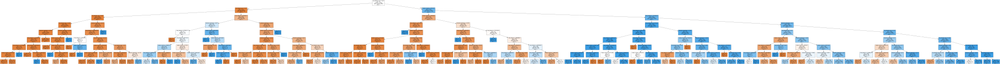

In [ ]:
# DOT data
# For class names:
#   0 represents False (not hazardous)
#   1 represents True (hazardous)
dot_data = tree.export_graphviz(classification_tree_md,
                                feature_names = features,
                                class_names = ['0', '1'],
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph

#### Results

| **Variant** | **Precision Score** | **Recall Score** | **Accuracy Score** | **F1 Score** |
|-------------|---------------------|------------------|--------------------|--------------|
| Vanilla     | 0.94090             | 0.94044          | 0.94073            | 0.94067      |
| Depth       | 0.82583             | 0.98792          | 0.88988            | 0.89963      |

When I limit the maximum depth to eight nodes, the precision score tanks from 0.94090 to 0.82583, the accuracy score drops from 0.94073 to 0.88988, and the f1 score falls from 0.94067 to 0.89963. Surprisingly, the recall score rises from 0.94044 to 0.98792.

In terms of output, limiting the depth returns a much smaller tree than it does by default. It also takes less time to process computationally, and this extends to how it took far less time to generate an image of the tree than it did by default. Since it is smaller, it is more easy to understand and faster to read through all the decisions.

As for what results get outputted, the limited decision tree does not explore as much as the unlimited decision tree. With the limited depth comes a wider search space than it is by default, and it is in this scope that more false positives were able to sneak in. Additionally, it managed to fit less false negatives. This could be because the wider search space managed to exclude more false negatives than false positives. As the algorithm runs for longer, its search spaces become smaller, which reduces how many false positives there are at the consequence of letting in more false negatives. Accuracy is the number of true positives and negatives out of all the results. With a large number of false positives and small number of false negatives, the accuracy is bound to fall. f1 scores are based on precision and recall. The limited tree's greater recall is overpowered by the much lower precision. Due to this, the f1 score significantly drops.

### Bagging
I will use the Random Forest algorithm as my Bagging ensemble method.

#### Random Forest Implementation
We use the [Random Forest classifier](https://www.datacamp.com/tutorial/random-forests-classifier-python) provided by sklearn. Additionally, we use [*k*-fold cross validation](https://www.askpython.com/python/examples/k-fold-cross-validation) to find how effective this algorithm is. Fortunately, we do not need to use StandardScalar on the data while inside the loop as [no feature scaling is required](http://theprofessionalspoint.blogspot.com/2019/02/advantages-and-disadvantages-of-random.html). Linked are my sources including pages that helped me write this code.

In [ ]:
# for this homework, we set k to 5
k = 5
kf = KFold(n_splits = k, random_state = None)

In [ ]:
rfc = RandomForestClassifier(n_estimators = 100)

precisions = []
recalls = []
accuracies = []
f1s = []

In [ ]:
for train_index, test_index in kf.split(X_resampled):
  X_train , X_test = X_resampled.iloc[train_index,:], X_resampled.iloc[test_index,:]
  y_train , y_test = y_resampled[train_index] , y_resampled[test_index]

  rfc = rfc.fit(X_train,y_train)
  y_pred_rfc = rfc.predict(X_test)

  precision = precision_score(y_test, y_pred_rfc)
  recall = recall_score(y_test, y_pred_rfc)
  accuracy = accuracy_score(y_test, y_pred_rfc)
  f1 = f1_score(y_test, y_pred_rfc)

  precisions.append(precision)
  recalls.append(recall)
  accuracies.append(accuracy)
  f1s.append(f1)

In [ ]:
# overall precision of the model
average_precisions = sum(precisions) / k
average_precisions

0.7944532734119731

In [ ]:
# overall recall of the model
average_recalls = sum(recalls) / k
average_recalls

0.8148076752959504

In [ ]:
# overall acuracy of the model
average_accuracies = sum(accuracies) / k
average_accuracies

0.9460344483358561

In [ ]:
# overall f1 score of the model
average_f1 = sum(f1s) / k
average_f1

0.8041581125911164

### Boosting
I will use the AdaBoost algorithm as my Boosting ensemble method.

#### AdaBoost Implementation
We use the AdaBoost code provided in [Lecture 3](https://github.com/Uzmamushtaque/CSCI4962-Projects-ML-AI/blob/main/Lecture_3.ipynb). Additionally, we use [*k*-fold cross validation](https://www.askpython.com/python/examples/k-fold-cross-validation) to find how effective this algorithm is.

In [ ]:
# for this homework, we set k to 5
k = 5
kf = KFold(n_splits = k, random_state = None)

In [ ]:
abc = AdaBoostClassifier(n_estimators=8, random_state=0, algorithm='SAMME')

precisions = []
recalls = []
accuracies = []
f1s = []

In [ ]:
for train_index, test_index in kf.split(X_resampled):
  X_train , X_test = X_resampled.iloc[train_index,:], X_resampled.iloc[test_index,:]
  y_train , y_test = y_resampled[train_index] , y_resampled[test_index]

  abc = abc.fit(X_train,y_train)
  y_pred_abc = abc.predict(X_test)

  precision = precision_score(y_test, y_pred_abc)
  recall = recall_score(y_test, y_pred_abc)
  accuracy = accuracy_score(y_test, y_pred_abc)
  f1 = f1_score(y_test, y_pred_abc)

  precisions.append(precision)
  recalls.append(recall)
  accuracies.append(accuracy)
  f1s.append(f1)

In [ ]:
# overall precision of the model
average_precisions = sum(precisions) / k
average_precisions

0.6562464935566419

In [ ]:
# overall recall of the model
average_recalls = sum(recalls) / k
average_recalls

0.9886335539176733

In [ ]:
# overall acuracy of the model
average_accuracies = sum(accuracies) / k
average_accuracies

0.8762575321503648

In [ ]:
# overall f1 score of the model
average_f1 = sum(f1s) / k
average_f1

0.7453009720610566

### Bagging and Boosting Comments

| **Method** | **Precision Score** | **Recall Score** | **Accuracy Score** | **F1 Score** |
|------------|---------------------|------------------|--------------------|--------------|
| Random Forests    | 0.79445             | 0.81481          | 0.94603            | 0.80416      |
| AdaBoost   | 0.65625             | 0.98863          | 0.87626            | 0.74530      |

The results seem quite different. The precision for Random Forests is much greater than AdaBoost at 0.79445 and 0.65625 respectively. For recall, however, Random Forests performs worse than AdaBoost at 0.81481 and 0.98863 respectively. This is the furthest metric between the two, with 0.17382 points separating them. Random Forests performs better in accuracy than AdaBoost at 0.94603 and 0.87626 respectively. As for F1 score, Random Forests wins against AdaBoost at 0.80416 and 0.74530 respectively. This ends up being the closest metric between the two, with 0.05886 points separating them.

### Comparing Effectiveness

| **Model**      | **Precision Score** | **Recall Score** | **Accuracy Score** | **F1 Score** |
|----------------|---------------------|------------------|--------------------|--------------|
| Decision Tree  | 0.94090             | 0.94044          | 0.94073            | 0.94067      |
| Random Forests | 0.79445             | 0.81481          | 0.94603            | 0.80416      |
| AdaBoost       | 0.65625             | 0.98863          | 0.87626            | 0.74530      |
| Decision Tree `max_depth` = 8       | 0.82583             | 0.98792          | 0.88988            | 0.89963      |

I used [this webpage](https://towardsdatascience.com/accuracy-precision-recall-or-f1-331fb37c5cb9) on accuracy, precision, recall, and f1 scores to help write this section.

Out of the three models I implemented, AdaBoost performs the best with a recall score of 0.98863, with Decision Tree following closely behind at a recall score of 0.94044 and Random Forests sitting further back with a recall score of 0.81481. The metric I am using for comparison here is recall score, which is the number of true positives divided by the total of actual positives.

This is an appropriate metric for the problem at hand, determining whether or not a Nearest Earth Object is hazardous to Earth, because there is a high cost associated with a false negative. If an asteroid is labeled as non-hazardous but proceeds to collide with Earth, there would at least be property damage and at most a potential extinction event not unlike the one faced by the dinosaurs. Conversely, if an asteroid is labeled as hazardous but does not proceed to collide with Earth, no real damage is done. It may send people into a panic and trigger defensive measures, but this outcome is preferable to the grim alternative. Our goal, in this case, would be to minimize false negatives by prioritizing the recall score.

Choosing different metrics can impact how these algorithms rank against each other. If we chose precision score, we would do so on the basis it reduces false positives. Labelling less asteroids as false positives would mean less defensive measures need to be taken and less panicking occurring at the cost of more asteroids possibly impacting Earth after being labeled as false negatives. Minimizing false positives would be done by prioritizing the precision score. When doing this, Decision Tree wins with score 0.94090, Random Forests takes second with score 0.79445, and AdaBoost comes third with score 0.65625.

Alternatively, we could choose accuracy. This metric has the closest spread with Random Forests at 0.94603, Decision Tree at 0.94073, and AdaBoost at 0.87626. This is the default metric people look toward for performance. However, it does not reflect this situation best as accuracy only counts true positives and true negatives out of all the examples. False positives and false negatives do pose a threat - one can raise concern while the other can cause damage.

This is where the f1 score comes into play. It is intended to balance precision and recall. If we use this, Decision Tree is first at 0.94067, Random Forests is second at 0.80416, and AdaBoost is third at 0.74530. f1 score uses precision and recall in its calculation. In this case, the extra recall score gained by AdaBoost is not enough to overcome its loss in precision, which is why it sinks to the bottom. Random Forests is consistent in precision and recall, which slots it in second. On top is Decision Tree, sitting there because its precision and recall scores are equally as high. 

The above results are taken with a Decision Tree that has no depth limit. Overfitting is rampant in this, however. If we look at Decision Tree's performances when its maximum depth is limited to 8, we notice it still leads in precision and f1 score, but it does so with less of a margin. Additionally, its recall score is less than AdaBoost, and its accuracy score is closer to AdaBoost than it is to Random Forests. The overfitting has curtailed a bit, and in the process, the other algorithms can show more of their benefits.

These results demonstrates that accuracy is not the only measure to focus on. Other metrics may be relevant like precision if the goal is to reduce false positives, recall if the goal is to reduce false negatives, and f1 score if both should be considered. They have a tangible impact in picking which model is best to measure that metric.

Further considerations than these can be made. In terms of time, Random Forests takes a long time as multiple Decision Trees run, and this is its core weakness alongside complexity. In terms of overfitting, without bounds, Decision Tree would be the worst offender as it keeps exploring. In terms of stability, AdaBoost can be severely impacted by noisy data and outliers, which I suspect may have been part of why its performance was less than expected. In any case, the limitations each model poses must be balanced alongside the benefits it grants to find what works best for a given dataset.